# Task 2

---

## Predictive modeling of customer bookings

This Jupyter notebook includes some code to get you started with this predictive modeling task. We will use various packages for data manipulation, feature engineering and machine learning.

### Exploratory data analysis

First, we must explore the data in order to better understand what we have and the statistical properties of the dataset.

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv(r"/content/customer_booking.csv", encoding="ISO-8859-1", skipinitialspace=True)
df.head()

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0


The `.head()` method allows us to view the first 5 rows in the dataset, this is useful for visual inspection of our columns

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   num_passengers         50000 non-null  int64  
 1   sales_channel          50000 non-null  object 
 2   trip_type              50000 non-null  object 
 3   purchase_lead          50000 non-null  int64  
 4   length_of_stay         50000 non-null  int64  
 5   flight_hour            50000 non-null  int64  
 6   flight_day             50000 non-null  object 
 7   route                  50000 non-null  object 
 8   booking_origin         50000 non-null  object 
 9   wants_extra_baggage    50000 non-null  int64  
 10  wants_preferred_seat   50000 non-null  int64  
 11  wants_in_flight_meals  50000 non-null  int64  
 12  flight_duration        50000 non-null  float64
 13  booking_complete       50000 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory usage: 5.3+ 

The `.info()` method gives us a data description, telling us the names of the columns, their data types and how many null values we have. Fortunately, we have no null values. It looks like some of these columns should be converted into different data types, e.g. flight_day.

To provide more context, below is a more detailed data description, explaining exactly what each column means:

- `num_passengers` = number of passengers travelling
- `sales_channel` = sales channel booking was made on
- `trip_type` = trip Type (Round Trip, One Way, Circle Trip)
- `purchase_lead` = number of days between travel date and booking date
- `length_of_stay` = number of days spent at destination
- `flight_hour` = hour of flight departure
- `flight_day` = day of week of flight departure
- `route` = origin -> destination flight route
- `booking_origin` = country from where booking was made
- `wants_extra_baggage` = if the customer wanted extra baggage in the booking
- `wants_preferred_seat` = if the customer wanted a preferred seat in the booking
- `wants_in_flight_meals` = if the customer wanted in-flight meals in the booking
- `flight_duration` = total duration of flight (in hours)
- `booking_complete` = flag indicating if the customer completed the booking

Before we compute any statistics on the data, lets do any necessary data conversion

In [ ]:
df["flight_day"].unique()

array(['Sat', 'Wed', 'Thu', 'Mon', 'Sun', 'Tue', 'Fri'], dtype=object)

In [ ]:
mapping = {
    "Mon": 1,
    "Tue": 2,
    "Wed": 3,
    "Thu": 4,
    "Fri": 5,
    "Sat": 6,
    "Sun": 7,
}

df["flight_day"] = df["flight_day"].map(mapping)
# cat_df_flights_replace.replace(replace_map_comp, inplace=True)

In [ ]:
df["flight_day"].unique()

array([6, 3, 4, 1, 7, 2, 5])

In [ ]:
df.describe()

,num_passengers,purchase_lead,length_of_stay,flight_hour,flight_day,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
count,50000.000000,50000.000000,50000.00000,50000.00000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,1.591240,84.940480,23.04456,9.06634,3.814420,0.668780,0.296960,0.427140,7.277561,0.149560
std,1.020165,90.451378,33.88767,5.41266,1.992792,0.470657,0.456923,0.494668,1.496863,0.356643
min,1.000000,0.000000,0.00000,0.00000,1.000000,0.000000,0.000000,0.000000,4.670000,0.000000
25%,1.000000,21.000000,5.00000,5.00000,2.000000,0.000000,0.000000,0.000000,5.620000,0.000000
50%,1.000000,51.000000,17.00000,9.00000,4.000000,1.000000,0.000000,0.000000,7.570000,0.000000
75%,2.000000,115.000000,28.00000,13.00000,5.000000,1.000000,1.000000,1.000000,8.830000,0.000000
max,9.000000,867.000000,778.00000,23.00000,7.000000,1.000000,1.000000,1.000000,9.500000,1.000000


The `.describe()` method gives us a summary of descriptive statistics over the entire dataset (only works for numeric columns). This gives us a quick overview of a few things such as the mean, min, max and overall distribution of each column.

From this point, you should continue exploring the dataset with some visualisations and other metrics that you think may be useful. Then, you should prepare your dataset for predictive modelling. Finally, you should train your machine learning model, evaluate it with performance metrics and output visualisations for the contributing variables. All of this analysis should be summarised in your single slide.

In [ ]:
import numpy as np

# data viz
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns

In [ ]:
# apply some cool styling
plt.style.use("ggplot")
rcParams['figure.figsize'] = (12,  6)

In [ ]:
# Use the keep parameter to consider only the first instance of a duplicate row to be unique
# bool_series = df.duplicated(keep='first')
# print('Boolean series:')
# print(bool_series)
# print('\n')
# print('DataFrame after keeping only the first instance of the duplicate rows:')

# # The `~` sign is used for negation. It changes the boolean value True to False and False to True.

# df[~bool_series]

In [ ]:
#ages = titanic["Age"]
sales_variable = df["sales_channel"]
sales_variable

0        Internet
1        Internet
2        Internet
3        Internet
4        Internet
           ...   
49995    Internet
49996    Internet
49997    Internet
49998    Internet
49999    Internet
Name: sales_channel, Length: 50000, dtype: object

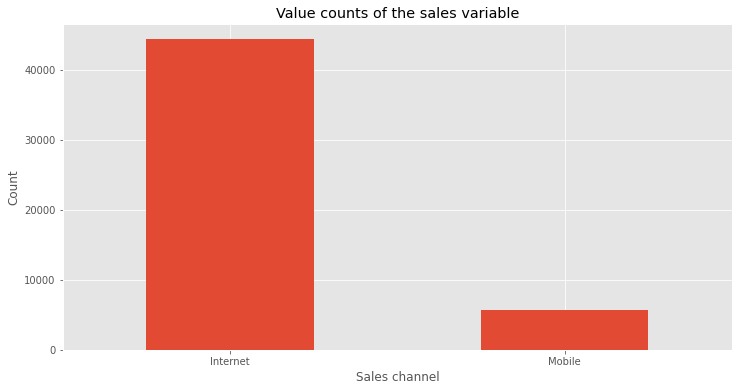

In [ ]:
sales_variable.value_counts().plot(kind="bar")
plt.title("Value counts of the sales variable")
plt.xlabel("Sales channel")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

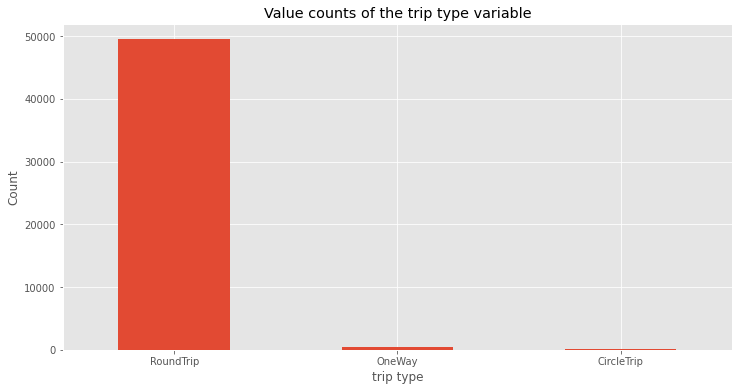

In [ ]:
trip = df["trip_type"]
trip.value_counts().plot(kind="bar")
plt.title("Value counts of the trip type variable")
plt.xlabel("trip type")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

In [ ]:
df.booking_complete.describe

<bound method NDFrame.describe of 0        0
1        0
2        0
3        0
4        0
        ..
49995    0
49996    0
49997    0
49998    0
49999    0
Name: booking_complete, Length: 50000, dtype: int64>

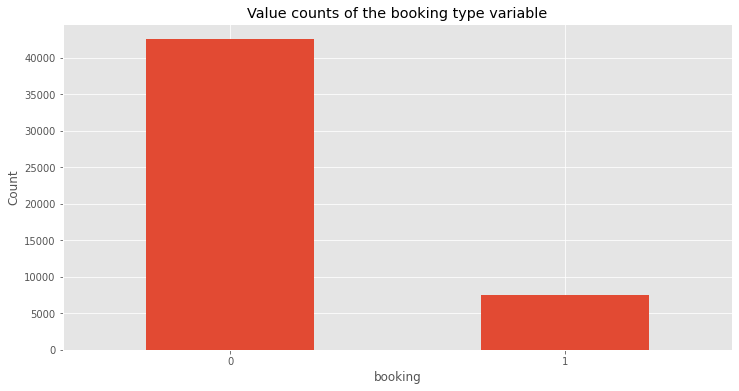

In [ ]:
booking = df["booking_complete"]
booking.value_counts().plot(kind="bar")
plt.title("Value counts of the booking type variable")
plt.xlabel("booking")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

In [ ]:
cat_df = df.select_dtypes(include=['object']).copy()
cat_df

,sales_channel,trip_type,route,booking_origin
0,Internet,RoundTrip,AKLDEL,New Zealand
1,Internet,RoundTrip,AKLDEL,New Zealand
2,Internet,RoundTrip,AKLDEL,India
3,Internet,RoundTrip,AKLDEL,New Zealand
4,Internet,RoundTrip,AKLDEL,India
...,...,...,...,...
49995,Internet,RoundTrip,PERPNH,Australia
49996,Internet,RoundTrip,PERPNH,Australia
49997,Internet,RoundTrip,PERPNH,Australia
49998,Internet,RoundTrip,PERPNH,Australia


In [ ]:
cat_df['sales_channel']

0        Internet
1        Internet
2        Internet
3        Internet
4        Internet
           ...   
49995    Internet
49996    Internet
49997    Internet
49998    Internet
49999    Internet
Name: sales_channel, Length: 50000, dtype: object

In [ ]:
cat_df = pd.get_dummies(cat_df, columns=['sales_channel'], prefix = ['channel'])

print(cat_df.head())

   trip_type   route booking_origin  channel_Internet  channel_Mobile
0  RoundTrip  AKLDEL    New Zealand                 1               0
1  RoundTrip  AKLDEL    New Zealand                 1               0
2  RoundTrip  AKLDEL          India                 1               0
3  RoundTrip  AKLDEL    New Zealand                 1               0
4  RoundTrip  AKLDEL          India                 1               0


In [ ]:
cat_df = pd.get_dummies(cat_df, columns=['trip_type'], prefix = ['trip'])
print(cat_df.head())

    route booking_origin  channel_Internet  channel_Mobile  trip_CircleTrip  \
0  AKLDEL    New Zealand                 1               0                0   
1  AKLDEL    New Zealand                 1               0                0   
2  AKLDEL          India                 1               0                0   
3  AKLDEL    New Zealand                 1               0                0   
4  AKLDEL          India                 1               0                0   

   trip_OneWay  trip_RoundTrip  
0            0               1  
1            0               1  
2            0               1  
3            0               1  
4            0               1  


In [ ]:
cat_df = pd.get_dummies(cat_df, columns=['route'], prefix = ['route'])
print(cat_df.head())

  booking_origin  channel_Internet  channel_Mobile  trip_CircleTrip  \
0    New Zealand                 1               0                0   
1    New Zealand                 1               0                0   
2          India                 1               0                0   
3    New Zealand                 1               0                0   
4          India                 1               0                0   

   trip_OneWay  trip_RoundTrip  route_AKLDEL  route_AKLHGH  route_AKLHND  \
0            0               1             1             0             0   
1            0               1             1             0             0   
2            0               1             1             0             0   
3            0               1             1             0             0   
4            0               1             1             0             0   

   route_AKLICN  ...  route_TGGXIY  route_TPETRZ  route_TPETWU  route_TPEURT  \
0             0  ...             0  

In [ ]:
cat_df = pd.get_dummies(cat_df, columns=['booking_origin'], prefix = ['booking'])
print(cat_df.head())

   channel_Internet  channel_Mobile  trip_CircleTrip  trip_OneWay  \
0                 1               0                0            0   
1                 1               0                0            0   
2                 1               0                0            0   
3                 1               0                0            0   
4                 1               0                0            0   

   trip_RoundTrip  route_AKLDEL  route_AKLHGH  route_AKLHND  route_AKLICN  \
0               1             1             0             0             0   
1               1             1             0             0             0   
2               1             1             0             0             0   
3               1             1             0             0             0   
4               1             1             0             0             0   

   route_AKLKIX  ...  booking_Timor-Leste  booking_Tonga  booking_Tunisia  \
0             0  ...                    0    

In [ ]:
cat_df

,channel_Internet,channel_Mobile,trip_CircleTrip,trip_OneWay,trip_RoundTrip,route_AKLDEL,route_AKLHGH,route_AKLHND,route_AKLICN,route_AKLKIX,...,booking_Timor-Leste,booking_Tonga,booking_Tunisia,booking_Turkey,booking_Ukraine,booking_United Arab Emirates,booking_United Kingdom,booking_United States,booking_Vanuatu,booking_Vietnam
0,1,0,0,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49996,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49997,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49998,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
concatenated_df = pd.concat([df, cat_df], axis="columns")

In [ ]:
concatenated_df.head()

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,...,booking_Timor-Leste,booking_Tonga,booking_Tunisia,booking_Turkey,booking_Ukraine,booking_United Arab Emirates,booking_United Kingdom,booking_United States,booking_Vanuatu,booking_Vietnam
0,2,Internet,RoundTrip,262,19,7,6,AKLDEL,New Zealand,1,...,0,0,0,0,0,0,0,0,0,0
1,1,Internet,RoundTrip,112,20,3,6,AKLDEL,New Zealand,0,...,0,0,0,0,0,0,0,0,0,0
2,2,Internet,RoundTrip,243,22,17,3,AKLDEL,India,1,...,0,0,0,0,0,0,0,0,0,0
3,1,Internet,RoundTrip,96,31,4,6,AKLDEL,New Zealand,0,...,0,0,0,0,0,0,0,0,0,0
4,2,Internet,RoundTrip,68,22,15,3,AKLDEL,India,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
concatenated_df.drop(['sales_channel', 'trip_type', 'route', 'booking_origin'], axis=1)

,num_passengers,purchase_lead,length_of_stay,flight_hour,flight_day,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete,...,booking_Timor-Leste,booking_Tonga,booking_Tunisia,booking_Turkey,booking_Ukraine,booking_United Arab Emirates,booking_United Kingdom,booking_United States,booking_Vanuatu,booking_Vietnam
0,2,262,19,7,6,1,0,0,5.52,0,...,0,0,0,0,0,0,0,0,0,0
1,1,112,20,3,6,0,0,0,5.52,0,...,0,0,0,0,0,0,0,0,0,0
2,2,243,22,17,3,1,1,0,5.52,0,...,0,0,0,0,0,0,0,0,0,0
3,1,96,31,4,6,0,0,1,5.52,0,...,0,0,0,0,0,0,0,0,0,0
4,2,68,22,15,3,1,0,1,5.52,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,27,6,9,6,1,0,1,5.62,0,...,0,0,0,0,0,0,0,0,0,0
49996,1,111,6,4,7,0,0,0,5.62,0,...,0,0,0,0,0,0,0,0,0,0
49997,1,24,6,22,6,0,0,1,5.62,0,...,0,0,0,0,0,0,0,0,0,0
49998,1,15,6,11,1,1,0,1,5.62,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
concatenated_df.head()

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,...,booking_Timor-Leste,booking_Tonga,booking_Tunisia,booking_Turkey,booking_Ukraine,booking_United Arab Emirates,booking_United Kingdom,booking_United States,booking_Vanuatu,booking_Vietnam
0,2,Internet,RoundTrip,262,19,7,6,AKLDEL,New Zealand,1,...,0,0,0,0,0,0,0,0,0,0
1,1,Internet,RoundTrip,112,20,3,6,AKLDEL,New Zealand,0,...,0,0,0,0,0,0,0,0,0,0
2,2,Internet,RoundTrip,243,22,17,3,AKLDEL,India,1,...,0,0,0,0,0,0,0,0,0,0
3,1,Internet,RoundTrip,96,31,4,6,AKLDEL,New Zealand,0,...,0,0,0,0,0,0,0,0,0,0
4,2,Internet,RoundTrip,68,22,15,3,AKLDEL,India,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
copy_concanetated_df = concatenated_df.copy()

In [ ]:
booking_target = concatenated_df['booking_complete']
concatenated_df = concatenated_df.drop(columns=['booking_complete'])
concatenated_df.insert(loc=921, column='booking_complete', value=booking_target)
concatenated_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Columns: 922 entries, num_passengers to booking_complete
dtypes: float64(1), int64(9), object(4), uint8(908)
memory usage: 48.6+ MB


In [ ]:
concatenated_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Columns: 922 entries, num_passengers to booking_complete
dtypes: float64(1), int64(9), object(4), uint8(908)
memory usage: 48.6+ MB


In [ ]:
concatenated_df.to_csv('cleaned_data.csv')

In [ ]:
features_df = concatenated_df.iloc[:,:-1]
features_df

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,...,booking_Timor-Leste,booking_Tonga,booking_Tunisia,booking_Turkey,booking_Ukraine,booking_United Arab Emirates,booking_United Kingdom,booking_United States,booking_Vanuatu,booking_Vietnam
0,2,Internet,RoundTrip,262,19,7,6,AKLDEL,New Zealand,1,...,0,0,0,0,0,0,0,0,0,0
1,1,Internet,RoundTrip,112,20,3,6,AKLDEL,New Zealand,0,...,0,0,0,0,0,0,0,0,0,0
2,2,Internet,RoundTrip,243,22,17,3,AKLDEL,India,1,...,0,0,0,0,0,0,0,0,0,0
3,1,Internet,RoundTrip,96,31,4,6,AKLDEL,New Zealand,0,...,0,0,0,0,0,0,0,0,0,0
4,2,Internet,RoundTrip,68,22,15,3,AKLDEL,India,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,Internet,RoundTrip,27,6,9,6,PERPNH,Australia,1,...,0,0,0,0,0,0,0,0,0,0
49996,1,Internet,RoundTrip,111,6,4,7,PERPNH,Australia,0,...,0,0,0,0,0,0,0,0,0,0
49997,1,Internet,RoundTrip,24,6,22,6,PERPNH,Australia,0,...,0,0,0,0,0,0,0,0,0,0
49998,1,Internet,RoundTrip,15,6,11,1,PERPNH,Australia,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
new_features_df = features_df.drop(columns=['sales_channel', 'trip_type', 'route', 'booking_origin'])

In [ ]:
new_features_df.iloc[:, 0:921]

,num_passengers,purchase_lead,length_of_stay,flight_hour,flight_day,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,channel_Internet,...,booking_Timor-Leste,booking_Tonga,booking_Tunisia,booking_Turkey,booking_Ukraine,booking_United Arab Emirates,booking_United Kingdom,booking_United States,booking_Vanuatu,booking_Vietnam
0,2,262,19,7,6,1,0,0,5.52,1,...,0,0,0,0,0,0,0,0,0,0
1,1,112,20,3,6,0,0,0,5.52,1,...,0,0,0,0,0,0,0,0,0,0
2,2,243,22,17,3,1,1,0,5.52,1,...,0,0,0,0,0,0,0,0,0,0
3,1,96,31,4,6,0,0,1,5.52,1,...,0,0,0,0,0,0,0,0,0,0
4,2,68,22,15,3,1,0,1,5.52,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,27,6,9,6,1,0,1,5.62,1,...,0,0,0,0,0,0,0,0,0,0
49996,1,111,6,4,7,0,0,0,5.62,1,...,0,0,0,0,0,0,0,0,0,0
49997,1,24,6,22,6,0,0,1,5.62,1,...,0,0,0,0,0,0,0,0,0,0
49998,1,15,6,11,1,1,0,1,5.62,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
target_df = concatenated_df.iloc[:,-1]

In [ ]:
target_df

0        0
1        0
2        0
3        0
4        0
        ..
49995    0
49996    0
49997    0
49998    0
49999    0
Name: booking_complete, Length: 50000, dtype: int64

In [ ]:
# Using Skicit-learn to split data into training and testing sets
from sklearn.model_selection import train_test_split
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(new_features_df, target_df, test_size = 0.30, random_state = 42)

In [ ]:
print('Training Features Shape:', new_features_df.shape)
print('Training Labels Shape:', target_df.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (50000, 917)
Training Labels Shape: (50000,)
Testing Features Shape: (15000, 917)
Testing Labels Shape: (15000,)


In [ ]:
# Import the model we are using
from sklearn.ensemble import RandomForestClassifier# Instantiate model with 1000 decision trees
rf = RandomForestClassifier(n_estimators = 100, random_state = 42)# Train the model on training data
rf.fit(new_features_df, target_df)

RandomForestClassifier(random_state=42)

In [ ]:
# Use the forest's predict method on the test data
predictions = rf.predict(new_features_df)# Calculate the absolute errors
errors = abs(predictions - target_df)# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2), '.')

Mean Absolute Error: 0.0 .


In [ ]:
from sklearn.metrics import accuracy_score

predictions = rf.predict(test_features)
accuracy = accuracy_score(test_labels, predictions)
print(accuracy)

0.9998666666666667


In [ ]:
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

In [ ]:
target_df = target_df.to_frame()

In [ ]:
from sklearn.tree import export_graphviz
import graphviz

estimator = rf.estimators_[5]
dot_data = export_graphviz(estimator,out_file=None, impurity=True, feature_names=new_features_df.columns)
graph = graphviz.Source(dot_data, format='png')
graph

In [ ]:
graph.render('random_forest_tree')

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.17599 to fit


'random_forest_tree.png'

In [ ]:
from sklearn.model_selection import cross_val_score
np.mean(cross_val_score(rf, train_features, train_labels, cv=10))

0.8480571428571428